<a href="https://colab.research.google.com/github/veronichaflasma/Machine-Learning-Expert/blob/main/Credit_Scoring_Classifications.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Credit Scoring Classification**

**Name: Flasma Veronicha H**

# **1. Import Library**

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import plotly.express as px
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split

# Model Library
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import AdaBoostRegressor

from sklearn.preprocessing import StandardScaler

# **2. Data Collection**

Import datasets from Kaggle

In [2]:
# Install Kaggle package
!pip install -q Kaggle

# Upload Kaggle API
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"veronichaflasmah","key":"53b42bfd609cd86993353140f9fa6029"}'}

In [3]:
# Create directory and change the permission
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!ls ~/.kaggle

kaggle.json


In [4]:
# Download and copy the dataset's API
!kaggle datasets download -d sudhanshu2198/processed-data-credit-score

  0% 0.00/4.12M [00:00<?, ?B/s]
100% 4.12M/4.12M [00:00<00:00, 254MB/s]


In [5]:
# Unzip the dataset
!mkdir credit-scoring
!unzip processed-data-credit-score.zip -d credit-scoring
!ls credit-scoring

Archive:  processed-data-credit-score.zip
  inflating: credit-scoring/Score.csv  
Score.csv


# **3. Data Understanding**

In [6]:
credit = pd.read_csv("/content/credit-scoring/Score.csv")
credit.head()

,Delay_from_due_date,Num_of_Delayed_Payment,Num_Credit_Inquiries,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Amount_invested_monthly,Monthly_Balance,Credit_Score,Credit_Mix,...,Age,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Monthly_Inhand_Salary,Changed_Credit_Limit,Outstanding_Debt,Total_EMI_per_month
0,3.0,7.0,4.0,26.822620,265.0,No,80.415295,312.494089,Good,Good,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
1,3.0,7.0,4.0,31.944960,265.0,No,118.280222,284.629162,Good,Good,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
2,3.0,7.0,4.0,28.609352,267.0,No,81.699521,331.209863,Good,Good,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
3,5.0,4.0,4.0,31.377862,268.0,No,199.458074,223.451310,Good,Good,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
4,6.0,4.0,4.0,24.797347,269.0,No,41.420153,341.489231,Good,Good,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949


**credit.info()** is use for quickly understanding the structure and composition of the DataFrame. It helps to identify missing values, understand the data types, and estimate the memory footprint of the DataFrame.

In [7]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99960 entries, 0 to 99959
Data columns (total 21 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Delay_from_due_date       99960 non-null  float64
 1   Num_of_Delayed_Payment    99960 non-null  float64
 2   Num_Credit_Inquiries      99960 non-null  float64
 3   Credit_Utilization_Ratio  99960 non-null  float64
 4   Credit_History_Age        99960 non-null  float64
 5   Payment_of_Min_Amount     99960 non-null  object 
 6   Amount_invested_monthly   99960 non-null  float64
 7   Monthly_Balance           99960 non-null  float64
 8   Credit_Score              99960 non-null  object 
 9   Credit_Mix                99960 non-null  object 
 10  Payment_Behaviour         99960 non-null  object 
 11  Age                       99960 non-null  float64
 12  Annual_Income             99960 non-null  float64
 13  Num_Bank_Accounts         99960 non-null  float64
 14  Num_Cr

**credit.describe()** to understanding the distribution and basic statistics of numerical data within the DataFrame. It provides insights into the central tendency, spread, and range of values for each numerical column

In [8]:
credit.describe().T

,count,mean,std,min,25%,50%,75%,max
Delay_from_due_date,99960.0,21.095718,14.827414,0.000000,10.000000,18.000000,28.000000,67.000000
Num_of_Delayed_Payment,99960.0,13.336345,6.269964,0.000000,9.000000,14.000000,18.000000,28.000000
Num_Credit_Inquiries,99960.0,5.774570,3.862224,0.000000,3.000000,5.000000,8.000000,29.000000
Credit_Utilization_Ratio,99960.0,32.284544,5.116888,20.000000,28.052051,32.305470,36.496305,50.000000
Credit_History_Age,99960.0,221.122819,99.696084,1.000000,144.000000,219.000000,302.000000,404.000000
Amount_invested_monthly,99960.0,193.665219,194.782737,0.000000,73.708522,129.342067,234.323706,1977.326102
Monthly_Balance,99960.0,403.445100,214.387092,0.007760,270.317007,337.237873,471.904834,1602.040519
Age,99960.0,33.269228,10.762371,14.000000,24.000000,33.000000,42.000000,56.000000
Annual_Income,99960.0,50498.704153,38294.243161,7005.930000,19338.480000,36996.830000,71681.400000,179987.280000
Num_Bank_Accounts,99960.0,5.368868,2.591668,0.000000,3.000000,5.000000,7.000000,10.000000


# **4. Exploratory Data Analysis (EDA)**

This step is to analyzing data sets to summarize main characteristics, often with visual methods.

* **Delay_from_due_date:** Represents the average number of days delayed from the payment date
* **Num_of_Delayed_Payment:** Represents the average number of payments delayed by a person
* **Num_Credit_Inquiries:** Represents the number of credit card inquiries
* **Credit_Utilization_Ratio:** Represents the utilization ratio of credit card
* **Credit_History_Age:** Represents the age of credit history of the person
* **Amount_invested_monthly:** Represents the monthly amount invested by the customer (in USD)
* **Monthly_Balance:** Represents the monthly balance amount of the customer (in USD)
* **Age:** Represents the age of the person
* **Annual_Income:** Represents the annual income of the person
* **Num_Bank_Accounts:** Represents the number of bank accounts a person holds
* **Num_Credit_Card:** Represents the number of other credit cards held by a person
* **Interest_Rate:** Represents the interest rate on credit card
* **Num_of_Loan:** Represents the number of loans taken from the bank
* **Monthly_Inhand_Salary:** Represents the monthly base salary of a person
* **Outstanding_Debt:** Represents the remaining debt to be paid (in USD)
* **Total_EMI_per_month:** Represents the monthly EMI payments (in USD)

In [9]:
# Function to visualize the target variable distribution
def visualize_class(data, target_encoding='Credit_Score', figsize=(10, 4), palette='viridis'):
    sns.set_style('whitegrid')
    plt.figure(figsize=figsize)

    rel_freq = data[target_encoding].value_counts(normalize=True, ascending=False) * 100

    ax = sns.barplot(x=rel_freq.values, y=rel_freq.index, palette=palette)

    for i in range(rel_freq.shape[0]):
        ax.text(rel_freq.values[i] + 0.5, i, str(round(rel_freq.values[i], 1)) + '%',
                ha='left', va='center', color='black', fontsize=10)

    # Calculate total count of data points
    total_count = len(data)

    # Calculate value counts of each class/category
    class_counts = data[target_encoding].value_counts()

    class_info = ', '.join([f'{class_name}: {class_count}' for class_name, class_count in class_counts.items()])
    plt.text(0, -1, f'Total Data: {total_count}\n{class_info}', ha='left', va='center', fontsize=12)

    plt.xlabel('Relative Frequency (%)', fontsize=14)
    plt.ylabel(target_encoding.replace('_', ' ').title(), fontsize=14)
    plt.tight_layout()
    plt.show()

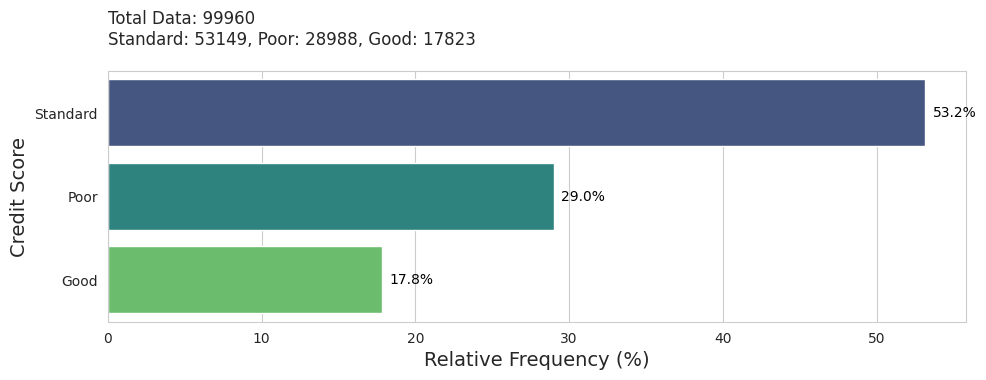

<Figure size 640x480 with 0 Axes>

In [10]:
visualize_class(credit)
plt.savefig("image1.png")

In the context of credit analysis, the classification of **Credit Scores** into 3 categories - Good, Poor, and Standard - serves as a fundamental tool for evaluating the creditworthiness of individuals or entities. This classification process involves assessing various financial indicators and behavioral patterns associated with borrowers to determine their level of credit risk.

## **4.1 EDA - Univariate Analysis**

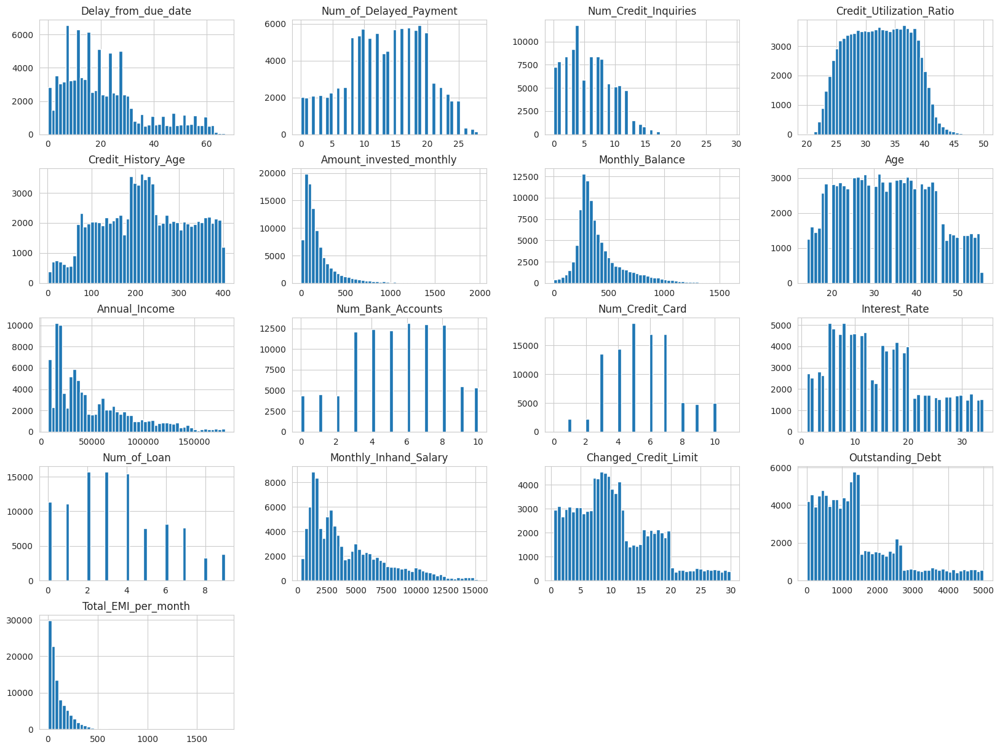

In [11]:
credit.hist(bins=50, figsize=(20,15))
plt.savefig(f"Univariate Analysis.png")
plt.show()

## **4.3 EDA - Analyze Correlation Credit Score**

In [12]:
col = ['Age', 'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Changed_Credit_Limit',
       'Num_Credit_Inquiries', 'Outstanding_Debt',
       'Credit_Utilization_Ratio', 'Credit_History_Age', 'Total_EMI_per_month',
       'Amount_invested_monthly', 'Monthly_Balance']

for c in col:
    fig = px.histogram(credit, x='Credit_Score', y=c,
                       histfunc='avg',
                       title=f"Relation between Credit_Score and {c}",
                       width=600, height=400)
    fig.show()
    plt.savefig(f"Analyze Correlation Credit Score.png")


<Figure size 640x480 with 0 Axes>

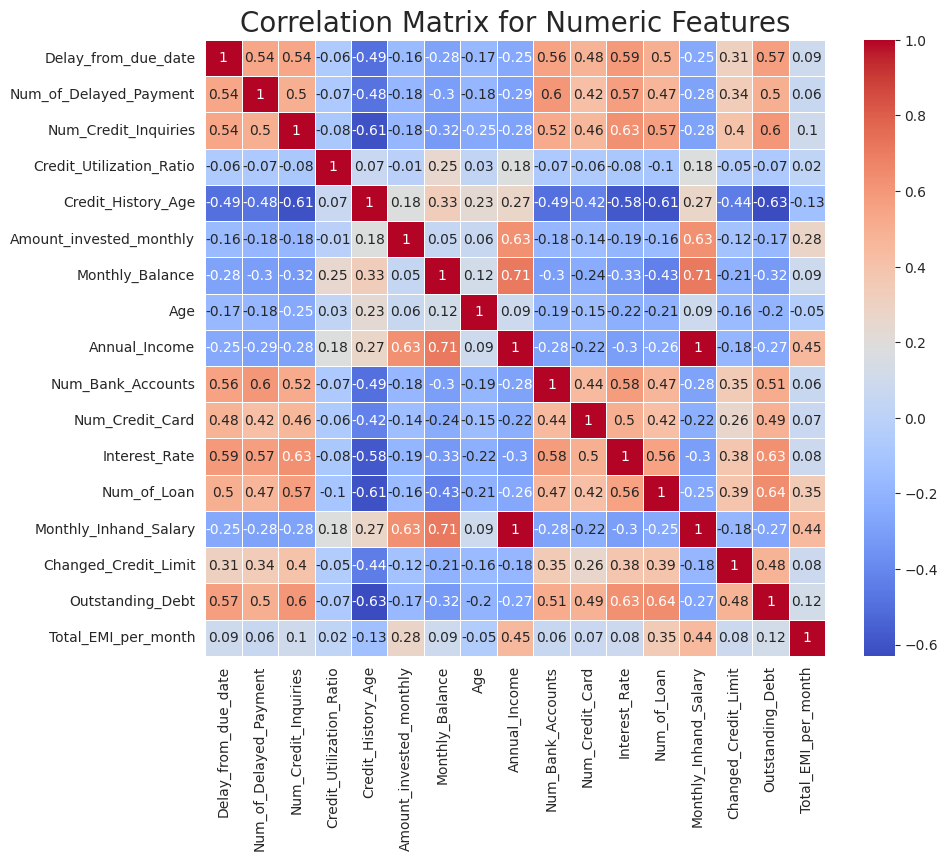

In [13]:
plt.figure(figsize=(10, 8))
correlation_matrix = credit.corr().round(2)

sns.heatmap(data=correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, )
plt.title(f"Correlation Matrix for Numeric Features", size=20)
plt.savefig(f"Correlation Matrix.png")

# **5. Data Preparation**

In [14]:
# Checking Missing Values in Each Column
missing = credit.isnull().sum()
missing_val = pd.DataFrame({'Missing Values': missing})
print(missing_val)

                          Missing Values
Delay_from_due_date                    0
Num_of_Delayed_Payment                 0
Num_Credit_Inquiries                   0
Credit_Utilization_Ratio               0
Credit_History_Age                     0
Payment_of_Min_Amount                  0
Amount_invested_monthly                0
Monthly_Balance                        0
Credit_Score                           0
Credit_Mix                             0
Payment_Behaviour                      0
Age                                    0
Annual_Income                          0
Num_Bank_Accounts                      0
Num_Credit_Card                        0
Interest_Rate                          0
Num_of_Loan                            0
Monthly_Inhand_Salary                  0
Changed_Credit_Limit                   0
Outstanding_Debt                       0
Total_EMI_per_month                    0


In [15]:
# Checking Duplicate Values
duplicate = credit.duplicated().sum()
print('Total of Duplicate Values: ', duplicate)

Total of Duplicate Values:  0


This step is replacing the value "NM" in the column 'Payment_of_Min_Amount' with the second most frequent value found in that column.

In [16]:
credit['Payment_of_Min_Amount'].value_counts()

Yes    52326
No     35628
NM     12006
Name: Payment_of_Min_Amount, dtype: int64

In [17]:
freq = credit['Payment_of_Min_Amount'].value_counts()
credit['Payment_of_Min_Amount'].replace({"NM":freq.index[1]},inplace=True)

In [18]:
credit['Credit_Mix'].value_counts()

Standard    45832
Good        30360
Bad         23768
Name: Credit_Mix, dtype: int64

In [19]:
credit['Credit_Score'] = credit['Credit_Score'].map({"Standard": 0, "Poor": 1, "Good": 2})
credit['Payment_of_Min_Amount'] = credit['Payment_of_Min_Amount'].map({"Yes": 0, "No": 1})
credit['Credit_Mix'] = credit['Credit_Mix'].map({"Standard": 0, "Good": 1, "Bad": 2})
credit['Payment_Behaviour'] = credit['Payment_Behaviour'].map(
    {"Low_spent_Small_value_payments": 0,
     "High_spent_Medium_value_payments": 1,
     "High_spent_Large_value_payments": 2,
     "Low_spent_Medium_value_payments": 3,
     "High_spent_Small_value_payments": 4,
     "Low_spent_Large_value_payments": 5,
     })

In [20]:
credit.head()

,Delay_from_due_date,Num_of_Delayed_Payment,Num_Credit_Inquiries,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Amount_invested_monthly,Monthly_Balance,Credit_Score,Credit_Mix,...,Age,Annual_Income,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Monthly_Inhand_Salary,Changed_Credit_Limit,Outstanding_Debt,Total_EMI_per_month
0,3.0,7.0,4.0,26.822620,265.0,1,80.415295,312.494089,2,1,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
1,3.0,7.0,4.0,31.944960,265.0,1,118.280222,284.629162,2,1,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
2,3.0,7.0,4.0,28.609352,267.0,1,81.699521,331.209863,2,1,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
3,5.0,4.0,4.0,31.377862,268.0,1,199.458074,223.451310,2,1,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949
4,6.0,4.0,4.0,24.797347,269.0,1,41.420153,341.489231,2,1,...,23.0,19114.12,3.0,4.0,3.0,4.0,1824.843333,11.27,809.98,49.574949


In [21]:
X = credit.drop('Credit_Score', axis=1)
y = credit['Credit_Score']

Splitting datasets 20% test size

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=14)

In [23]:
# fit transform X_train, but not X_test
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [24]:
# Make sure there is no missing value
missing = credit['Credit_Mix'].isnull().sum()
print(missing)

0


# **6. Build Model Classifier**

In [44]:
model_predict = []

## **6.1 KNN Classifier**

In [45]:
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)
y_pred = knn.predict(X_test)

In [46]:
model_predict.append(y_pred)

Accuracy: 0.7625550220088035
Classification Report: 
              precision    recall  f1-score   support

           0       0.78      0.80      0.79     10637
           1       0.76      0.76      0.76      5811
           2       0.71      0.66      0.68      3544

    accuracy                           0.76     19992
   macro avg       0.75      0.74      0.74     19992
weighted avg       0.76      0.76      0.76     19992



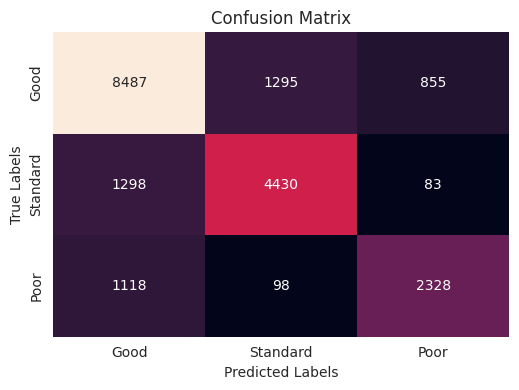

<Figure size 640x480 with 0 Axes>

In [47]:
# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred, zero_division=0)
conf_matrix = confusion_matrix(y_test, y_pred)

# Print Accuracy and Classification Report
print(f"Accuracy: {accuracy}")
print(f"Classification Report: \n{classification_rep}")

# Visualize the confusion matrix
plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt='g', cbar=False,
            xticklabels=['Good', 'Standard', 'Poor'],
            yticklabels=['Good', 'Standard', 'Poor'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

plt.tight_layout()
plt.show()
plt.savefig(f"KNN.png")

## **6.2 Random Forest Classifier**

In [48]:
rf = RandomForestClassifier(n_estimators=100)
rf.fit(X_train, y_train)
y_pred = rf.predict(X_test)

In [49]:
model_predict.append(y_pred)

Accuracy: 0.8129751900760304
Classification Report: 
              precision    recall  f1-score   support

           0       0.83      0.81      0.82     10637
           1       0.80      0.85      0.82      5811
           2       0.79      0.75      0.77      3544

    accuracy                           0.81     19992
   macro avg       0.80      0.80      0.80     19992
weighted avg       0.81      0.81      0.81     19992



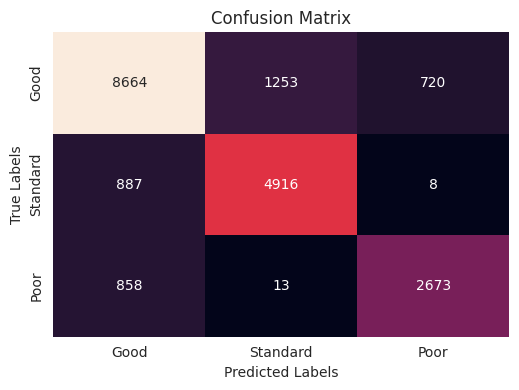

<Figure size 640x480 with 0 Axes>

In [50]:
# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred, zero_division=0)
conf_matrix = confusion_matrix(y_test, y_pred)

# Print Accuracy and Classification Report
print(f"Accuracy: {accuracy}")
print(f"Classification Report: \n{classification_rep}")

# Visualize the confusion matrix
plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt='g', cbar=False,
            xticklabels=['Good', 'Standard', 'Poor'],
            yticklabels=['Good', 'Standard', 'Poor'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

plt.tight_layout()
plt.show()
plt.savefig(f"KNN.png")

## **6.3 Naive Bayes Classifier**

In [51]:
nb = BernoulliNB()
nb.fit(X_train, y_train)
y_pred = nb.predict(X_test)

In [52]:
model_predict.append(y_pred)

Accuracy: 0.6342537014805922
Classification Report: 
              precision    recall  f1-score   support

           0       0.80      0.54      0.65     10637
           1       0.62      0.71      0.66      5811
           2       0.45      0.78      0.58      3544

    accuracy                           0.63     19992
   macro avg       0.63      0.68      0.63     19992
weighted avg       0.69      0.63      0.64     19992



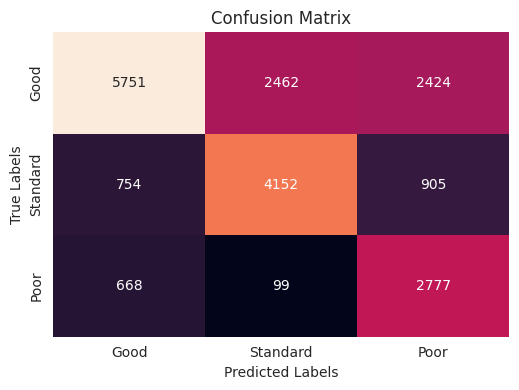

<Figure size 640x480 with 0 Axes>

In [53]:
# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred, zero_division=0)
conf_matrix = confusion_matrix(y_test, y_pred)

# Print Accuracy and Classification Report
print(f"Accuracy: {accuracy}")
print(f"Classification Report: \n{classification_rep}")

# Visualize the confusion matrix
plt.figure(figsize=(10, 4))

plt.subplot(1, 2, 1)
sns.heatmap(conf_matrix, annot=True, fmt='g', cbar=False,
            xticklabels=['Good', 'Standard', 'Poor'],
            yticklabels=['Good', 'Standard', 'Poor'])
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')

plt.tight_layout()
plt.show()
plt.savefig(f"nb.png")

# **7. Evaluation**

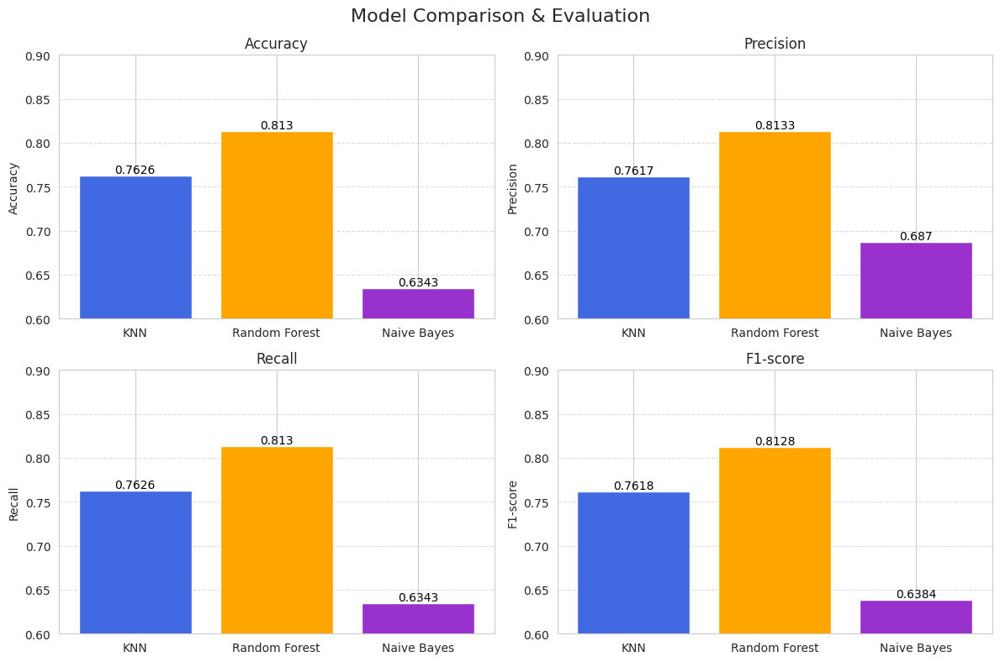

<Figure size 640x480 with 0 Axes>

In [61]:
models = ['KNN', 'Random Forest', 'Naive Bayes']

accuracy = [accuracy_score(y_test, y_pred) for y_pred in model_predict]
precision = [precision_score(y_test, y_pred, average='weighted', zero_division=0) for y_pred in model_predict]
recall = [recall_score(y_test, y_pred, average='weighted', zero_division=0) for y_pred in model_predict]
f1 = [f1_score(y_test, y_pred, average='weighted') for y_pred in model_predict]

fig, axs = plt.subplots(2, 2, figsize=(12, 8))

metrics = {'Accuracy': accuracy, 'Precision': precision, 'Recall': recall, 'F1-score': f1}
colors = ['royalblue', 'orange', 'darkorchid']

for i, (metric_name, metric_values) in enumerate(metrics.items()):
    ax = axs[i // 2, i % 2]
    bars = ax.bar(models, metric_values, color=colors)
    ax.set_title(metric_name)
    ax.set_ylabel(metric_name)
    ax.set_ylim(0.6, 0.9)
    ax.grid(axis='y', linestyle='--', alpha=0.7)
    for bar in bars:
        yval = bar.get_height()
        ax.text(bar.get_x() + bar.get_width()/2, yval, round(yval, 4), va='bottom', ha='center', fontsize=10, color='black')

# Add title to the entire figure
fig.suptitle('Model Comparison & Evaluation', fontsize=16)
plt.tight_layout()
plt.show()
plt.savefig("Result.png")
